
# **Image Colorization With Basic GAN**



In [1]:
from PIL import Image
from sklearn.model_selection import train_test_split
import tensorflow as tf
import numpy as np
from matplotlib import image
from matplotlib import pyplot as plt
import os
from tensorflow import keras

In [1]:
# 用于Google colab
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google.colab'

In [ ]:
# 用于Google colab
!unzip /content/drive/MyDrive/img_color_data.zip

## **1. 下载和处理数据**

- 解压缩用于训练 GAN 模型的图像数据集
- 数据来源：https://www.kaggle.com/datasets/aayush9753/image-colorization-dataset

---

这段代码定义了一些变量用于配置训练和测试数据集的路径以及其他参数。

- **batch_size** 表示每个训练批次的图像数量，它决定了每次模型更新时使用的样本数量。
- **img_size** 表示训练模型所需的图像尺寸，它指定了图像在输入模型之前需要调整的大小。
- 接下来的四个变量分别指定了训练集和测试集中黑白图像和彩色图像的路径。

In [4]:
# 用于训练的批次大小
batch_size = 64

# 训练模型所需的图像尺寸
img_size = 120

# 训练集划分
dataset_split = 2500

master_dir = '/img_color_data/data'

1. 通过**遍历指定目录下的图像文件**，使用PIL.Image.open打开每个图像文件，并调整大小为指定的img_size。

2. 将RGB图像转换为灰度图像（使用convert('L')方法），并将图像数据归一化到[0, 1]范围内，**得到灰度图像数组gray_img_array和彩色图像数组rgb_img_array**。

3. 使用train_test_split函数**将数据划分为训练集和测试集**，其中train_x和train_y分别是训练集的灰度图像数组和彩色图像数组，test_x和test_y分别是测试集的灰度图像数组和彩色图像数组。

4. 通过tf.data.Dataset.from_tensor_slices将**训练集数据转化**为tf.data.Dataset对象，并使用batch方法指定批次大小为batch_size。

In [5]:
x = []
y = []
for image_file in os.listdir( master_dir )[ 0 : dataset_split ]:
    rgb_image = Image.open( os.path.join( master_dir , image_file ) ).resize( ( img_size , img_size ) )
    # Normalize the RGB image array
    rgb_img_array = (np.asarray( rgb_image ) ) / 255
    gray_image = rgb_image.convert( 'L' )
    # Normalize the grayscale image array
    gray_img_array = ( np.asarray( gray_image ).reshape( ( img_size , img_size , 1 ) ) ) / 255
    # Append both the image arrays
    x.append( gray_img_array )
    y.append( rgb_img_array )

# Train-test splitting
train_x, test_x, train_y, test_y = train_test_split( np.array(x) , np.array(y) , test_size=0.1 )

# Construct tf.data.Dataset object
dataset = tf.data.Dataset.from_tensor_slices( ( train_x , train_y ) )
dataset = dataset.batch( batch_size )


2023-06-28 13:13:11.051319: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-28 13:13:12.213950: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 10249 MB memory:  -> device: 0, name: NVIDIA RTX A2000 12GB, pci bus id: 0000:08:00.0, compute capability: 8.6


## **2. GAN**

在本部分，使用Keras创建Gan模型，实现生成器Generator和判别器Discriminator以及对应的损失函数




### **A. Generator**

这个生成器模型是一个基于卷积神经网络的图像生成模型，它将输入的单通道图像编码为一个低维表示，然后通过解码器将低维表示解码为与原始输入图像相似的三通道图像。

生成器模型的结构如下：

- **输入层**：接受一个单通道的图像作为输入，形状为 (img_size, img_size, 1)。
- **编码器部分**：由多个卷积层组成，每个卷积层后面跟着一个 LeakyReLU 激活函数。这些卷积层用于逐步提取输入图像的特征，并将其转换为低维表示。
- **瓶颈层**：一个带有 tanh 激活函数的卷积层，用于生成低维表示。
- **解码器部分**：由多个转置卷积层组成，用于将低维表示解码为与原始图像相似的三通道图像。每个转置卷积层后面跟着一个 ReLU 激活函数。

生成器模型通过编码器部分将输入图像转换为低维表示，然后通过解码器部分将低维表示解码为重建图像。它的目标是生成与原始图像尽可能相似的图像，以实现图像生成的任务。


In [6]:
def get_generator_model():

    inputs = tf.keras.layers.Input( shape=( img_size , img_size , 1 ) )

    conv1 = tf.keras.layers.Conv2D( 16 , kernel_size=( 5 , 5 ) , strides=1 )( inputs )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) , strides=1)( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) , strides=1)( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )

    conv2 = tf.keras.layers.Conv2D( 32 , kernel_size=( 5 , 5 ) , strides=1)( conv1 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) , strides=1 )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) , strides=1 )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )

    conv3 = tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1 )( conv2 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )

    bottleneck = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='tanh' , padding='same' )( conv3 )

    concat_1 = tf.keras.layers.Concatenate()( [ bottleneck , conv3 ] )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( concat_1 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( conv_up_3 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu' )( conv_up_3 )

    concat_2 = tf.keras.layers.Concatenate()( [ conv_up_3 , conv2 ] )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( concat_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( conv_up_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu' )( conv_up_2 )

    concat_3 = tf.keras.layers.Concatenate()( [ conv_up_2 , conv1 ] )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu')( concat_3 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu')( conv_up_1 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 3 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu')( conv_up_1 )

    model = tf.keras.models.Model( inputs , conv_up_1 )
    return model



### **B. Discriminator**

这个判别器模型是一个基于卷积神经网络的二分类模型，用于判断输入的图像是真实图像（类别为1）还是生成器生成的假图像（类别为0）。

判别器模型的结构如下：

- **输入层**：接受一个三通道的图像作为输入，形状为 (120, 120, 3)。
- **卷积层**：由多个卷积层组成，每个卷积层使用 ReLU 激活函数。这些卷积层用于逐步提取图像的特征。
- **池化层**：在每个池化层之后，图像的空间维度被减小，有助于减少模型的参数数量并提取更高级的特征。
- **扁平化层**：将多维张量转换为一维向量，为全连接层做准备。
- **全连接层**：包括几个全连接层，每个全连接层都使用 ReLU 激活函数。
- **输出层**：包含一个神经元，使用 sigmoid 激活函数将输出值映射到范围 [0, 1]，表示输入图像是真实图像的概率。

判别器模型的目标是根据输入图像的特征判断其真实性，输出一个介于 0 和 1 之间的概率值。它用于衡量生成器生成的图像与真实图像之间的差异，以进行对抗生成网络的训练。


In [7]:
def get_discriminator_model():
    layers = [
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7 , 7 ) , strides=1 , activation='relu' , input_shape=( 120 , 120 , 3 ) ),
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7, 7 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense( 512, activation='relu'  )  ,
        tf.keras.layers.Dense( 128 , activation='relu' ) ,
        tf.keras.layers.Dense( 16 , activation='relu' ) ,
        tf.keras.layers.Dense( 1 , activation='sigmoid' )
    ]
    model = tf.keras.models.Sequential( layers )
    return model



### **C. Loss Functions**

下面的代码定义了两个损失函数和两个优化器，以及生成器模型和判别器模型的实例化。

- **discriminator_loss** 是判别器的损失函数，接受真实样本输出和生成样本输出作为输入。使用**二分类交叉熵损失函数**计算真实样本的损失和生成样本的损失，并返回总体损失。

- **generator_loss** 是生成器的损失函数，接受生成样本输出和真实标签作为输入。使用**均方误差损失函数**计算生成样本与真实标签之间的损失。

- **generator_optimizer** 是生成器的优化器，这里使用了 **Adam** 优化算法，学习率为 0.0005。

- **discriminator_optimizer** 是判别器的优化器，同样使用了 **Adam** 优化算法，学习率为 0.0005。

In [8]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
mse = tf.keras.losses.MeanSquaredError()

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output) - tf.random.uniform( shape=real_output.shape , maxval=0.1 ) , real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output) + tf.random.uniform( shape=fake_output.shape , maxval=0.1  ) , fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output , real_y):
    real_y = tf.cast( real_y , 'float32' )
    return mse( fake_output , real_y )

generator_optimizer = tf.keras.optimizers.Adam( 0.0005 )
discriminator_optimizer = tf.keras.optimizers.Adam( 0.0005 )

generator = get_generator_model()
discriminator = get_discriminator_model()



## **3. Training The GAN**

通过这个训练步骤，可以实现生成器和判别器的训练过程，并根据损失函数的反馈来优化模型参数，以提高生成器生成真实图像的能力和判别器准确判别真实图像的能力


1. 在 tf.GradientTape() 上下文中，使用两个独立的 tf.GradientTape 对象 gen_tape 和 disc_tape 来记录生成器和判别器的操作。
2. **生成一个图像**，通过生成器模型 generator 对输入 input_x 进行前向传播，得到生成的图像 generated_images。
3. 将真实图像 real_y 分别输入给判别器模型 discriminator，得到**真实图像的输出** real_output 和**生成图像的输出** generated_output。
4. 计算**生成器的损失** gen_loss，这里使用的是 L2 损失函数，衡量生成图像和真实图像之间的差异。
5. 计算**判别器的损失** disc_loss，这里使用的是交叉熵损失函数，衡量真实图像和生成图像被判别为真实图像的概率差异。
6. 打印生成器和判别器的**损失之和**。
7. 计算生成器和判别器的**梯度**，分别针对生成器的可训练变量和判别器的可训练变量。
8. 使用**优化器** generator_optimizer 和 discriminator_optimizer，分别将梯度应用到生成器和判别器的可训练变量上，更新模型参数。

In [9]:
@tf.function
def train_step( input_x , real_y ):

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Generate an image -> G( x )
        generated_images = generator( input_x , training=True)
        # Probability that the given image is real -> D( x )
        real_output = discriminator( real_y, training=True)
        # Probability that the given image is the one generated -> D( G( x ) )
        generated_output = discriminator(generated_images, training=True)

        # L2 Loss -> || y - G(x) ||^2
        gen_loss = generator_loss( generated_images , real_y )
        # Log loss for the discriminator
        disc_loss = discriminator_loss( real_output, generated_output )

    #tf.keras.backend.print_tensor( tf.keras.backend.mean( gen_loss ) )
    tf.keras.backend.print_tensor( gen_loss + disc_loss )

    # Compute the gradients
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # Optimize with Adam
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))



- 对于每个训练轮 e，打印当前的轮数。
- 对于训练数据集 dataset 中的每个批次 (x, y)，调用 train_step(x, y) 来执行一次训练步骤。
- 在 train_step 中，生成器和判别器根据输入 x 和真实标签 y 进行前向传播和反向传播，并更新模型参数。
- 这个过程会重复执行，直到完成指定的训练轮数。

In [10]:
num_epochs = 150

for e in range( num_epochs ):
  print("epoch: ", e )
  print('loss: ')
  for ( x , y ) in dataset:
    # Here ( x , y ) represents a batch from our training dataset.
    #print( x.shape )
    train_step( x , y )
  # 保存训练好的generator模型
  generator.save('generator_model.h5')

epoch:  0
loss: 


2023-06-28 13:14:35.281473: I tensorflow/stream_executor/cuda/cuda_dnn.cc:368] Loaded cuDNN version 8101
2023-06-28 13:14:40.718764: I tensorflow/stream_executor/cuda/cuda_blas.cc:1786] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-06-28 13:14:47.594223: W tensorflow/core/common_runtime/bfc_allocator.cc:275] Allocator (GPU_0_bfc) ran out of memory trying to allocate 3.83GiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.
2023-06-28 13:14:47.594302: W tensorflow/core/common_runtime/bfc_allocator.cc:275] Allocator (GPU_0_bfc) ran out of memory trying to allocate 3.83GiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.
2023-06-28 13:14:48.436079: W tensorflow/core/common_runtime/bfc_allocator.cc:275] Allocator (GPU_0_bfc) ran out of 

 1.66226351
 1.57823014
 1.32747912
 4.43821287
 1.35408545
 1.34043837
 1.43016922
 1.46866572
 1.51065886
 1.4435457
 1.42439902
 1.41125989
 1.4160676
 1.48151124
 1.47219527
 1.4410013
 1.42911553
 1.43079352
 1.42852211
 1.42937768
 1.42818034
 1.42532992
 1.42733157
 1.42244232
 1.42961061
 1.42566741
 1.42066908
 1.41786575
 1.41386855
 1.40815747
 1.39919531
 1.38181353
 1.34112132
 1.29136717
 1.18830287
 1.18545043
epoch:  1
loss: 
 1.21072638
 1.1062001
 1.17425311
 1.11086345
 1.13460255
 1.12672067
 1.21926892
 1.13120377
 1.13143265
 1.1654458
 0.975579917
 0.965905368
 1.01202297
 0.933279097
 0.882220566
 1.09198904
 1.04121757
 1.16149127
 1.11957312
 1.04381323
 1.03765893
 1.03250062
 0.986127853
 0.937984
 0.910335183
 0.863957345
 0.869138658
 0.986053169
 0.772156417
 0.897782266
 0.780140638
 0.891048491
 0.807702303
 0.800952256
 0.941422582
 1.08330166
epoch:  2
loss: 
 0.803003669
 0.820828
 0.784954369
 1.3024044
 0.774116695
 0.76127547
 0.895139217
 1.01715


## **4. Results**

用于计算图像重建质量评估指标的函数。它使用了skimage.metrics模块中的结构相似性指标（SSIM）和OpenCV库来计算峰值信噪比（PSNR）。

- **separation_channel**(original_image, reconstructed_image): 这个函数用于将原始图像和重建图像分离成各个通道。它使用OpenCV的cv2.split()函数来将图像拆分成通道，并返回原始图像和重建图像的通道列表。

- **get_psnr**(original_image, reconstructed_image): 这个函数用于计算峰值信噪比（PSNR）。它首先计算均方误差（MSE），然后使用最大像素值来计算PSNR值。

- **calculate_psnr**(original_image, reconstructed_image): 这个函数用于计算平均峰值信噪比（PSNR）。它将原始图像和重建图像分离成通道，并针对每个通道调用get_psnr()函数来计算PSNR值。最后，它计算所有通道的PSNR均值，并返回平均PSNR值。

- **calculate_ssim**(original_image, reconstructed_image): 这个函数用于计算平均结构相似性指标（SSIM）。它将原始图像和重建图像分离成通道，并针对每个通道调用skimage.metrics.structural_similarity()函数来计算SSIM值。最后，它计算所有通道的SSIM均值，并返回平均SSIM值。



In [12]:
from skimage.metrics import structural_similarity as ssim
import cv2
def separation_channel(original_image, reconstructed_image):
  original_image_channels = cv2.split(original_image)
  reconstructed_image_channels = cv2.split(reconstructed_image)
  return original_image_channels, reconstructed_image_channels

def get_psnr(original_image, reconstructed_image):
    mse = np.mean((original_image - reconstructed_image) ** 2)
    max_pixel_value = np.max(original_image)
    psnr = 20 * np.log10(max_pixel_value / np.sqrt(mse))
    return psnr

def calculate_psnr(original_image, reconstructed_image):
  psnr_values = []
  original_image_channels, reconstructed_image_channels = separation_channel(original_image, reconstructed_image)
  for original_channel, reconstructed_channel in zip(original_image_channels, reconstructed_image_channels):
    # 计算PSNR
    psnr = get_psnr(original_channel, reconstructed_channel)
    psnr_values.append(psnr)
  average_psnr = np.mean(psnr_values)
  return average_psnr

def calculate_ssim(original_image, reconstructed_image):
  ssim_values = []
  original_image_channels, reconstructed_image_channels = separation_channel(original_image, reconstructed_image)
  for original_channel, reconstructed_channel in zip(original_image_channels, reconstructed_image_channels):
    # 计算SSIM
    ssim_value = ssim(original_channel, reconstructed_channel, data_range=reconstructed_channel.max() - reconstructed_channel.min())
    ssim_values.append(ssim_value)
  average_ssim = np.mean(ssim_values)
  return average_ssim

- model = tf.keras.models.load_model('generator_model.h5'): 这行代码**加载了保存在generator_model.h5文件中的生成器模型**。使用tf.keras.models.load_model()函数可以从磁盘上加载已保存的模型。

- model.compile(loss='mse', optimizer='Adam'): 这行代码**对加载的模型进行编译**，指定了损失函数为均方误差（MSE）和优化器为Adam。编译模型是为了配置模型的训练参数，包括损失函数和优化器。

- y = model.predict(test_x): 这行代码**使用加载的模型对测试数据（test_x）进行预测**。model.predict()函数接受输入数据并返回生成器模型的预测输出。预测的结果将赋值给变量y。

In [13]:
model = tf.keras.models.load_model('generator_model.h5')
model.compile(loss='mse', optimizer='Adam')
y = model.predict(test_x)

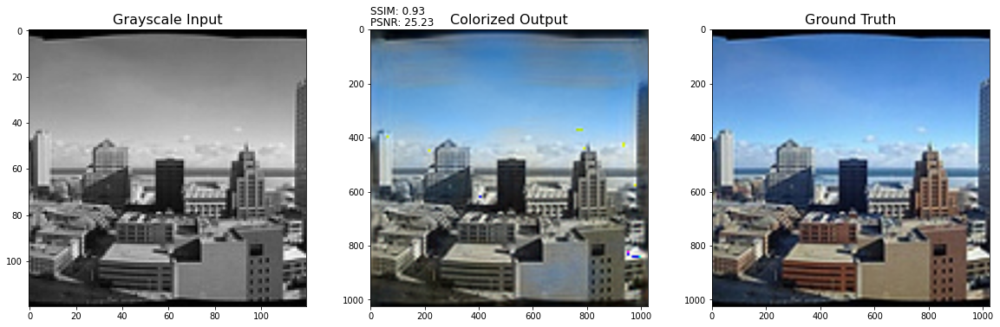

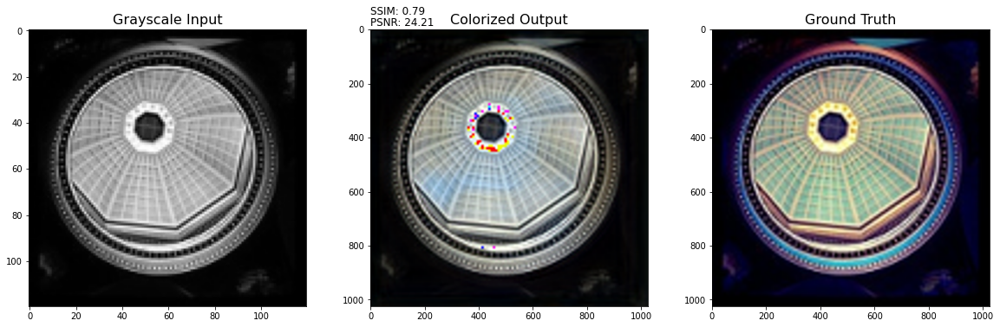

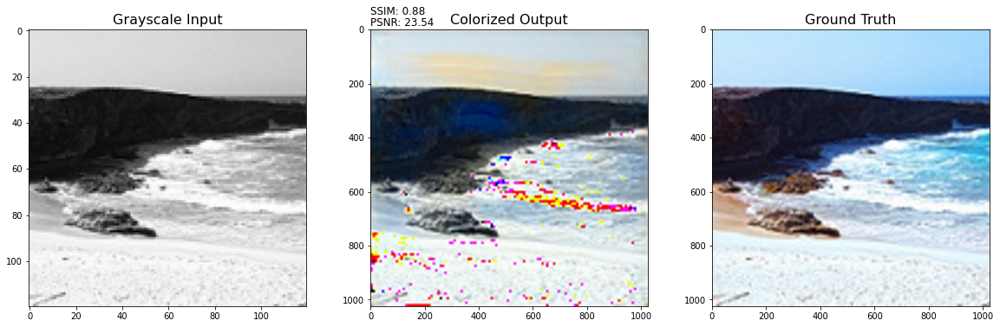

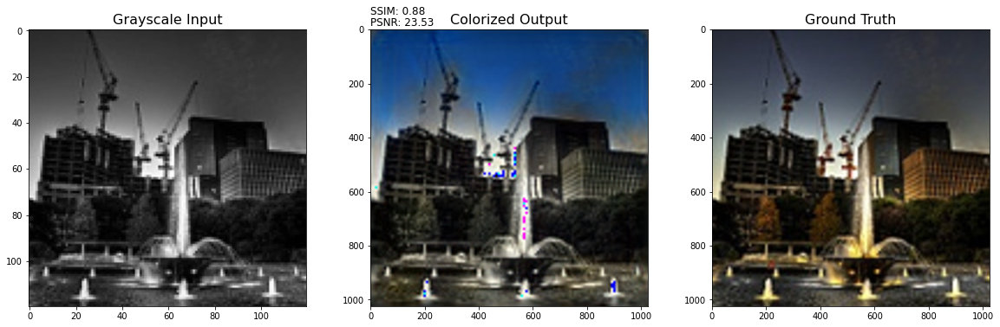

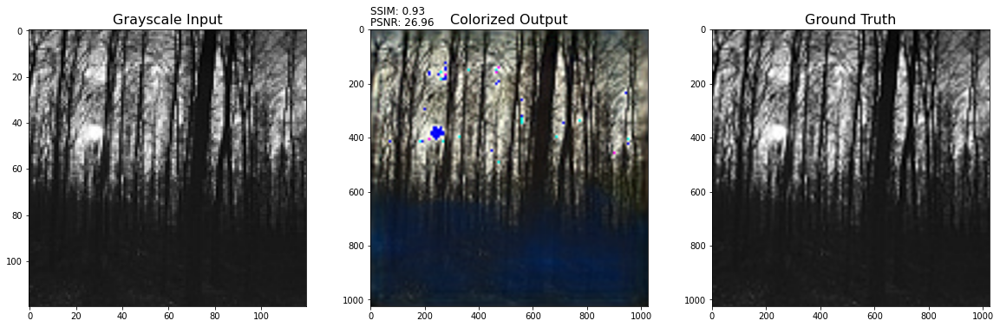

...

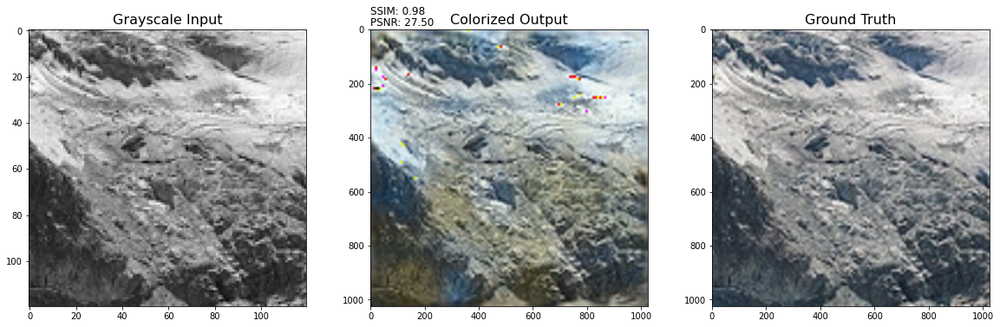

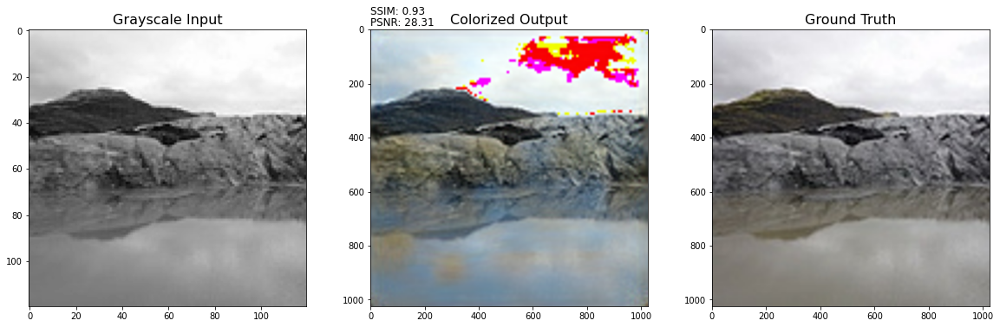

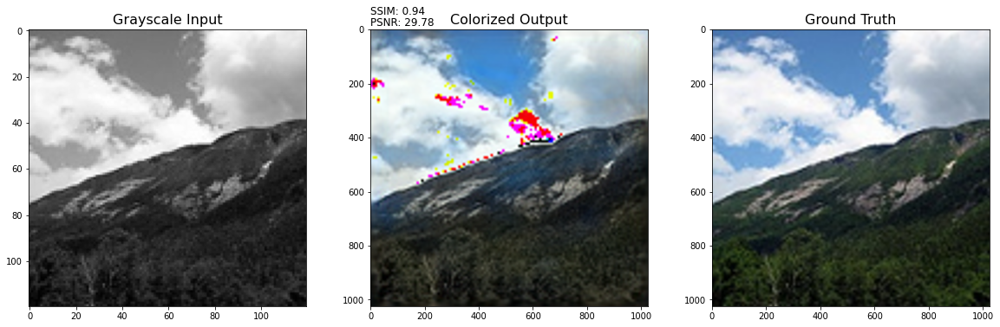

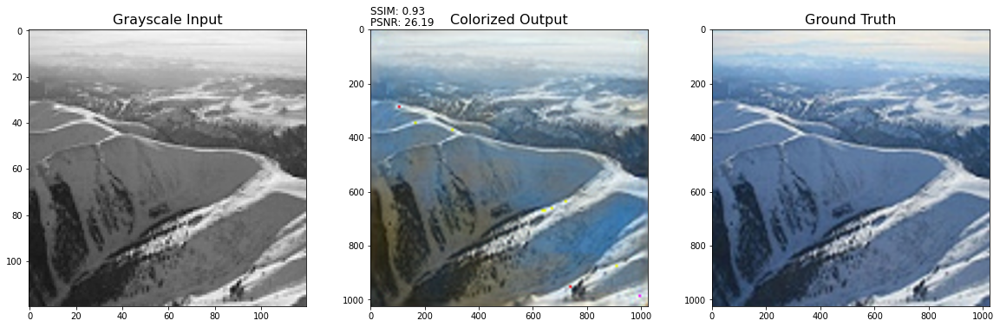

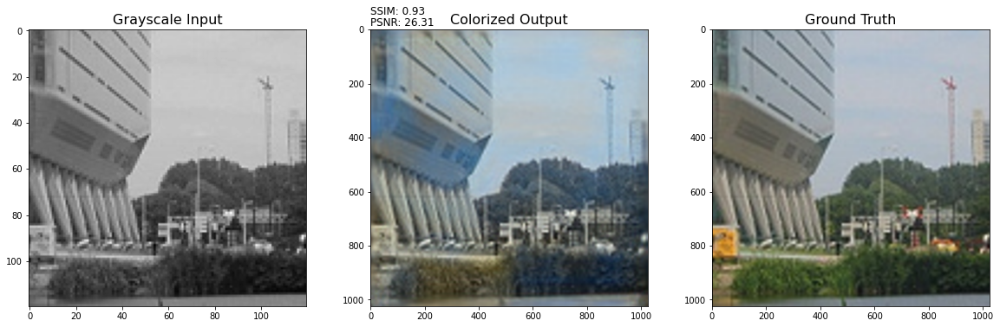

In [ ]:
# PSNR和SSIM比较
PSNR=[]
SSIM=[]
for i in range(len(test_x)):
  plt.figure(figsize=(20,20))
  or_image = plt.subplot(3,3,1)
  or_image.set_title('Grayscale Input', fontsize=16)
  plt.imshow( test_x[i].reshape((120,120)) , cmap='gray' )

  in_image = plt.subplot(3,3,2)
  image = Image.fromarray( ( y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  image = np.asarray( image )
  in_image.set_title('Colorized Output', fontsize=16)
  plt.imshow( image )

  # 计算并显示彩色化输出图像的PSNR和SSIM
  psnr_in = calculate_psnr(test_y[i], y[i])
  PSNR.append(psnr_in)
  ssim_in = calculate_ssim(test_y[i], y[i])
  SSIM.append(ssim_in)
  in_image.text(0, -15, f"PSNR: {psnr_in:.2f}", color='black', fontsize=12, ha='left')
  in_image.text(0, -55, f"SSIM: {ssim_in:.2f}", color='black', fontsize=12, ha='left')

  ou_image = plt.subplot(3,3,3)
  image = Image.fromarray( ( test_y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
  ou_image.set_title('Ground Truth', fontsize=16)
  plt.imshow( image )

  plt.show()

In [ ]:
# 计算平均PSNR、SSIM
psnr_aver = sum(PSNR)/len(PSNR)
print("Colorized Picture Average PSNR: ",psnr_aver)
ssim_aver = sum(SSIM)/len(SSIM)
print("Colorized Picture Average SSIM: ",ssim_aver)

Colorized Picture Average PSNR:  21.47302830621698
Colorized Picture Average SSIM:  0.7587403986308381
